<a href="https://colab.research.google.com/github/hdavidoff/n1health_dataChallenge/blob/main/n1health_datachallenge_cleaned.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#/content/drive/MyDrive/challenge.db

# Install and import necessary packages

In [1]:
pip install folium matplotlib mapclassify kaleido

In [2]:
import sqlite3
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#import contextily as ctx
import geopandas as gpd
import os
from mpl_toolkits.axes_grid1 import make_axes_locatable
import missingno as msno
import plotly.express as px
import plotly.graph_objects as go
from scipy import stats
import kaleido

# Which data do we have, first look at data

In [3]:
# connect to given database
conn = sqlite3.connect('/content/drive/MyDrive/challenge.db')


In [4]:
curs = conn.cursor()
curs.execute("SELECT name FROM sqlite_master WHERE type = 'table'").fetchall()


[('five_hundred_cities',), ('access',), ('variable_list',)]

Look at first dataset

In [5]:
query = "SELECT * FROM five_hundred_cities"
df = pd.read_sql_query(query, conn)
df.head()

,index,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,Population2010,ACCESS2_CrudePrev,ACCESS2_Crude95CI,ARTHRITIS_CrudePrev,...,PAPTEST_Crude95CI,PHLTH_CrudePrev,PHLTH_Crude95CI,SLEEP_CrudePrev,SLEEP_Crude95CI,STROKE_CrudePrev,STROKE_Crude95CI,TEETHLOST_CrudePrev,TEETHLOST_Crude95CI,Geolocation
0,0,AL,Birmingham,107000,1073000100,0107000-01073000100,3042,24.4,"(21.2, 27.8)",31.2,...,"(83.4, 86.6)",20.5,"(18.9, 22.2)",45.5,"(44.3, 46.5)",5.5,"( 5.0, 5.9)",28.9,"(23.7, 35.1)","(33.57943283260, -86.7228323926)"
1,1,AL,Birmingham,107000,1073000300,0107000-01073000300,2735,30.4,"(27.1, 33.7)",30.5,...,"(81.9, 85.6)",22.2,"(20.4, 24.0)",44.5,"(43.2, 45.7)",6.1,"( 5.5, 6.8)",32.9,"(25.5, 40.2)","(33.54282086860, -86.7524339780)"
2,2,AL,Birmingham,107000,1073000400,0107000-01073000400,3338,24.7,"(21.1, 28.5)",31.5,...,"(82.3, 86.8)",19.4,"(17.5, 21.4)",45.7,"(44.2, 47.0)",5.6,"( 5.0, 6.2)",28.6,"(22.0, 35.1)","(33.56324496330, -86.7640474064)"
3,3,AL,Birmingham,107000,1073000500,0107000-01073000500,2864,25.2,"(21.6, 29.0)",35.0,...,"(82.1, 86.5)",21.7,"(19.7, 23.9)",46.1,"(44.5, 47.4)",7.3,"( 6.5, 8.2)",34.0,"(24.4, 42.9)","(33.54424045940, -86.7749130719)"
4,4,AL,Birmingham,107000,1073000700,0107000-01073000700,2577,29.0,"(24.5, 33.8)",36.3,...,"(82.2, 87.1)",25.5,"(23.1, 28.0)",48.3,"(46.6, 49.7)",9.0,"( 8.1, 10.0)",43.2,"(33.2, 53.2)","(33.55254061390, -86.8016893706)"


In [6]:
df.shape

(27210, 64)

In [7]:
df['FIPS'] = df['Place_TractID'].apply(lambda x: x.split('-')[1][:5] if '-' in x else '15003')## checked the errors, they occur for honolulu which seems to have a Place_TractID in a different format then the rest, manually added for now
df.head()

,index,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,Population2010,ACCESS2_CrudePrev,ACCESS2_Crude95CI,ARTHRITIS_CrudePrev,...,PHLTH_CrudePrev,PHLTH_Crude95CI,SLEEP_CrudePrev,SLEEP_Crude95CI,STROKE_CrudePrev,STROKE_Crude95CI,TEETHLOST_CrudePrev,TEETHLOST_Crude95CI,Geolocation,FIPS
0,0,AL,Birmingham,107000,1073000100,0107000-01073000100,3042,24.4,"(21.2, 27.8)",31.2,...,20.5,"(18.9, 22.2)",45.5,"(44.3, 46.5)",5.5,"( 5.0, 5.9)",28.9,"(23.7, 35.1)","(33.57943283260, -86.7228323926)",01073
1,1,AL,Birmingham,107000,1073000300,0107000-01073000300,2735,30.4,"(27.1, 33.7)",30.5,...,22.2,"(20.4, 24.0)",44.5,"(43.2, 45.7)",6.1,"( 5.5, 6.8)",32.9,"(25.5, 40.2)","(33.54282086860, -86.7524339780)",01073
2,2,AL,Birmingham,107000,1073000400,0107000-01073000400,3338,24.7,"(21.1, 28.5)",31.5,...,19.4,"(17.5, 21.4)",45.7,"(44.2, 47.0)",5.6,"( 5.0, 6.2)",28.6,"(22.0, 35.1)","(33.56324496330, -86.7640474064)",01073
3,3,AL,Birmingham,107000,1073000500,0107000-01073000500,2864,25.2,"(21.6, 29.0)",35.0,...,21.7,"(19.7, 23.9)",46.1,"(44.5, 47.4)",7.3,"( 6.5, 8.2)",34.0,"(24.4, 42.9)","(33.54424045940, -86.7749130719)",01073
4,4,AL,Birmingham,107000,1073000700,0107000-01073000700,2577,29.0,"(24.5, 33.8)",36.3,...,25.5,"(23.1, 28.0)",48.3,"(46.6, 49.7)",9.0,"( 8.1, 10.0)",43.2,"(33.2, 53.2)","(33.55254061390, -86.8016893706)",01073


In [8]:
df['FIPS'].unique().shape

(326,)

how many rows per city

In [9]:
# get number of rows per PlaceName in df

rows_per_place = df.groupby('PlaceName')['PlaceName'].count()
print(rows_per_place)


PlaceName
Abilene         37
Akron           66
Alameda         16
Albany          51
Albuquerque    137
              ... 
Wyoming         14
Yakima          19
Yonkers         51
Youngstown      31
Yuma            29
Name: PlaceName, Length: 474, dtype: int64


Look at access dataset

In [10]:
query = "SELECT * FROM access"
df2 = pd.read_sql_query(query, conn)
df2.head()

,index,FIPS,State,County,LACCESS_POP10,LACCESS_POP15,PCH_LACCESS_POP_10_15,PCT_LACCESS_POP10,PCT_LACCESS_POP15,LACCESS_LOWI10,...,LACCESS_HISP15,PCT_LACCESS_HISP15,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15
0,0,1001,AL,Autauga,18428.439685,17496.693038,-5.056026,33.769657,32.062255,5344.427472,...,471.136164,0.863345,86.767975,0.159000,61.169869,0.112092,8.817961,0.016159,482.848633,0.884808
1,1,1003,AL,Baldwin,35210.814078,30561.264430,-13.204891,19.318473,16.767489,9952.144027,...,1377.874834,0.755973,212.946378,0.116833,181.649648,0.099662,14.819634,0.008131,1127.696098,0.618712
2,2,1005,AL,Barbour,5722.305602,6069.523628,6.067799,20.840972,22.105560,3135.676086,...,509.377525,1.855183,17.096410,0.062266,39.960527,0.145539,8.082376,0.029436,462.382655,1.684025
3,3,1007,AL,Bibb,1044.867327,969.378841,-7.224696,4.559753,4.230324,491.449066,...,8.596762,0.037516,1.994318,0.008703,2.513097,0.010967,0.000000,0.000000,5.259244,0.022951
4,4,1009,AL,Blount,1548.175559,3724.428242,140.568857,2.700840,6.497380,609.027708,...,497.489891,0.867886,8.428994,0.014705,28.938242,0.050484,1.062851,0.001854,202.914187,0.353990


In [11]:
#df2.iloc[1500:1750,:]

In [12]:
df2.shape

(3143, 45)

In [13]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3143 entries, 0 to 3142
Data columns (total 45 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   index                      3143 non-null   int64  
 1   FIPS                       3143 non-null   int64  
 2   State                      3143 non-null   object 
 3   County                     3143 non-null   object 
 4   LACCESS_POP10              3143 non-null   float64
 5   LACCESS_POP15              3124 non-null   float64
 6   PCH_LACCESS_POP_10_15      3117 non-null   float64
 7   PCT_LACCESS_POP10          3143 non-null   float64
 8   PCT_LACCESS_POP15          3124 non-null   float64
 9   LACCESS_LOWI10             3143 non-null   float64
 10  LACCESS_LOWI15             3123 non-null   float64
 11  PCH_LACCESS_LOWI_10_15     3115 non-null   float64
 12  PCT_LACCESS_LOWI10         3143 non-null   float64
 13  PCT_LACCESS_LOWI15         3123 non-null   float

In [14]:
## convert the FIPS column to string and add leading 0 if len = 4
df2['FIPS'] = df2['FIPS'].astype(str)
df2['FIPS'] = df2['FIPS'].apply(lambda x: '0' + x if len(x) == 4 else x)
df2.head()

,index,FIPS,State,County,LACCESS_POP10,LACCESS_POP15,PCH_LACCESS_POP_10_15,PCT_LACCESS_POP10,PCT_LACCESS_POP15,LACCESS_LOWI10,...,LACCESS_HISP15,PCT_LACCESS_HISP15,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15
0,0,01001,AL,Autauga,18428.439685,17496.693038,-5.056026,33.769657,32.062255,5344.427472,...,471.136164,0.863345,86.767975,0.159000,61.169869,0.112092,8.817961,0.016159,482.848633,0.884808
1,1,01003,AL,Baldwin,35210.814078,30561.264430,-13.204891,19.318473,16.767489,9952.144027,...,1377.874834,0.755973,212.946378,0.116833,181.649648,0.099662,14.819634,0.008131,1127.696098,0.618712
2,2,01005,AL,Barbour,5722.305602,6069.523628,6.067799,20.840972,22.105560,3135.676086,...,509.377525,1.855183,17.096410,0.062266,39.960527,0.145539,8.082376,0.029436,462.382655,1.684025
3,3,01007,AL,Bibb,1044.867327,969.378841,-7.224696,4.559753,4.230324,491.449066,...,8.596762,0.037516,1.994318,0.008703,2.513097,0.010967,0.000000,0.000000,5.259244,0.022951
4,4,01009,AL,Blount,1548.175559,3724.428242,140.568857,2.700840,6.497380,609.027708,...,497.489891,0.867886,8.428994,0.014705,28.938242,0.050484,1.062851,0.001854,202.914187,0.353990


In [15]:
df2['FIPS'].unique().shape

(3143,)

In [16]:
## connect the two datasets on the unique FIPS identifiers
merged_df = pd.merge(df, df2, on='FIPS')
merged_df.head()

,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,Population2010,ACCESS2_CrudePrev,ACCESS2_Crude95CI,ARTHRITIS_CrudePrev,...,LACCESS_HISP15,PCT_LACCESS_HISP15,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15
0,0,AL,Birmingham,107000,1073000100,0107000-01073000100,3042,24.4,"(21.2, 27.8)",31.2,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
1,1,AL,Birmingham,107000,1073000300,0107000-01073000300,2735,30.4,"(27.1, 33.7)",30.5,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
2,2,AL,Birmingham,107000,1073000400,0107000-01073000400,3338,24.7,"(21.1, 28.5)",31.5,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
3,3,AL,Birmingham,107000,1073000500,0107000-01073000500,2864,25.2,"(21.6, 29.0)",35.0,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
4,4,AL,Birmingham,107000,1073000700,0107000-01073000700,2577,29.0,"(24.5, 33.8)",36.3,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462


In [17]:
merged_df.shape

(27210, 109)

In [18]:
merged_df['FIPS'].unique().shape

(326,)

# Geographic visualizations

Let's add in some geographic context to understand the data better. Aka merge in with the tract level GIS data.

In [19]:
path = "/content/drive/MyDrive/500Cities_Tracts_11082016.zip"
gdf = gpd.read_file(path)


In [20]:
gdf ### merge with plctract10 (Place_TractID in merged_df)

,place2010,tract2010,ST,PlaceName,plctract10,PlcTrPop10,geometry
0,0107000,01073000100,01,Birmingham,0107000-01073000100,3042,"POLYGON ((-9653001.056 3974630.899, -9652982.0..."
1,0107000,01073000300,01,Birmingham,0107000-01073000300,2735,"POLYGON ((-9657462.853 3968794.996, -9657470.2..."
2,0107000,01073000400,01,Birmingham,0107000-01073000400,3338,"POLYGON ((-9657275.613 3972217.16, -9657275.39..."
3,0107000,01073000500,01,Birmingham,0107000-01073000500,2864,"POLYGON ((-9660666.406 3968887.964, -9660631.7..."
4,0107000,01073000700,01,Birmingham,0107000-01073000700,2577,"POLYGON ((-9661391.097 3968591.429, -9661398.2..."
...,...,...,...,...,...,...,...
29300,15003,15003009501,15,Honolulu County,15003009501,4893,"POLYGON ((-17595986.709 2450686.821, -17595988..."
29301,15003,15003006804,15,Honolulu County,15003006804,2835,"POLYGON ((-17577599.401 2435352.333, -17577543..."
29302,15003,15003002701,15,Honolulu County,15003002701,5093,"POLYGON ((-17567761.096 2428519.705, -17567760..."
29303,15003,15003003900,15,Honolulu County,15003003900,655,"POLYGON ((-17572613.958 2428743.983, -17572601..."


Merge the geopandas dataframe with the pandas merged dataframe

In [21]:
gdf_tot = gdf.merge(merged_df, left_on = 'plctract10', right_on='Place_TractID')
gdf_tot.head()

,place2010,tract2010,ST,PlaceName_x,plctract10,PlcTrPop10,geometry,index_x,StateAbbr,PlaceName_y,...,LACCESS_HISP15,PCT_LACCESS_HISP15,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15
0,0107000,01073000100,01,Birmingham,0107000-01073000100,3042,"POLYGON ((-9653001.056 3974630.899, -9652982.0...",0,AL,Birmingham,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
1,0107000,01073000300,01,Birmingham,0107000-01073000300,2735,"POLYGON ((-9657462.853 3968794.996, -9657470.2...",1,AL,Birmingham,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
2,0107000,01073000400,01,Birmingham,0107000-01073000400,3338,"POLYGON ((-9657275.613 3972217.16, -9657275.39...",2,AL,Birmingham,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
3,0107000,01073000500,01,Birmingham,0107000-01073000500,2864,"POLYGON ((-9660666.406 3968887.964, -9660631.7...",3,AL,Birmingham,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
4,0107000,01073000700,01,Birmingham,0107000-01073000700,2577,"POLYGON ((-9661391.097 3968591.429, -9661398.2...",4,AL,Birmingham,...,7097.673679,1.07791,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462


In [ ]:
## quick note these are the tract boundaries from 2010

In [ ]:
### filter on a state because otherwise the visualization will take forever
gdf_tot_filt = gdf_tot[gdf_tot.ST == '06']
gdf_tot_filt.explore(
    column = 'PCT_LACCESS_POP15',
    tooltip = ['PlaceName_x', 'PCT_LACCESS_POP15', 'Population2010'],
    tiles = 'CartoDB positron')

Buffered data was truncated after reaching the output size limit.

# Re-focus: access variables and their correlated health outcomes

Let's explore the access variables. + is there missing data in the merged dataset?


<Axes: >

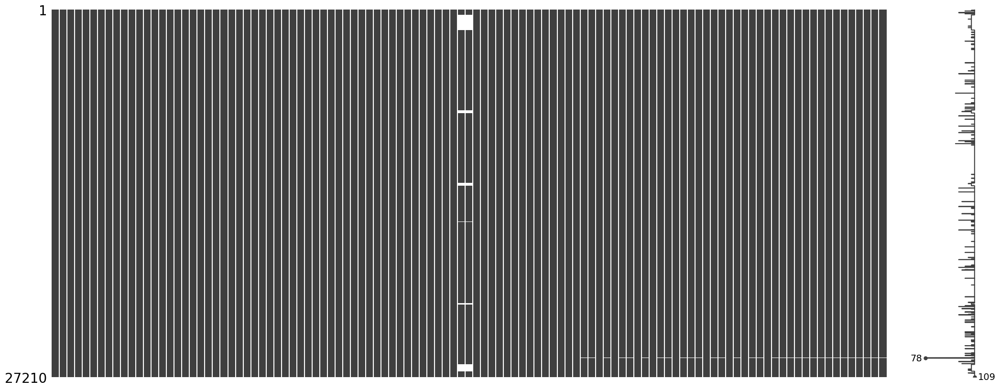

In [22]:
msno.matrix(merged_df)

<Axes: >

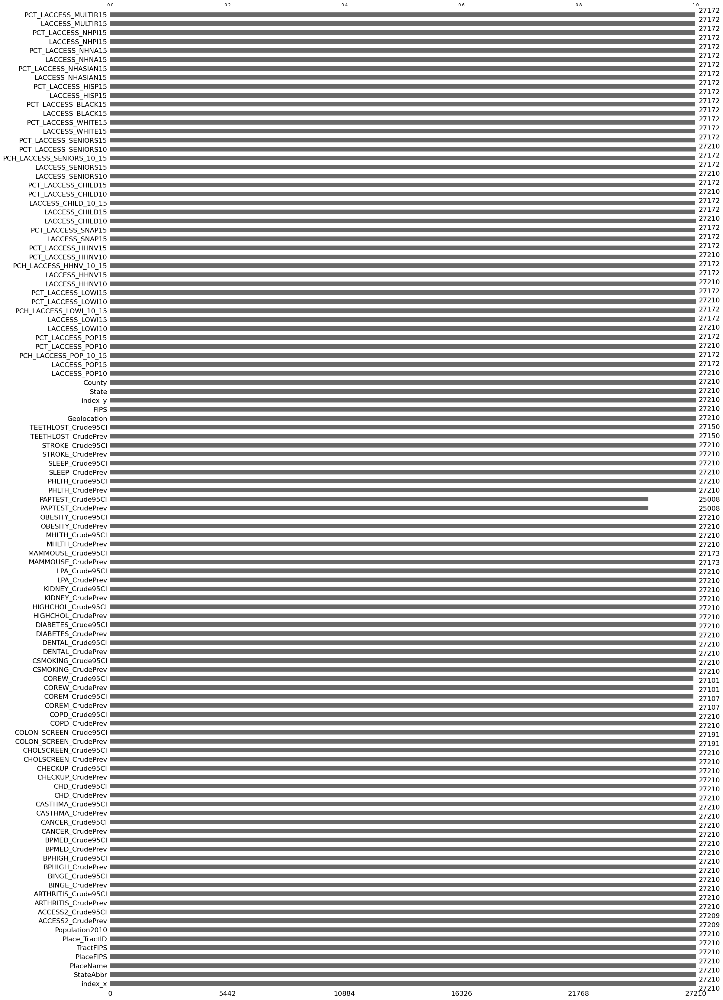

In [23]:
msno.bar(merged_df)

In [24]:
merged_df.groupby('FIPS').count().sort_values('PlaceName')

,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,Population2010,ACCESS2_CrudePrev,ACCESS2_Crude95CI,ARTHRITIS_CrudePrev,...,LACCESS_HISP15,PCT_LACCESS_HISP15,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15
FIPS,,,,,,,,,,,,,,,,,,,,,
08035,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
37037,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
55139,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
48071,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
48257,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36081,646,646,646,646,646,646,646,646,646,646,...,646,646,646,646,646,646,646,646,646,646
36047,749,749,749,749,749,749,749,749,749,749,...,749,749,749,749,749,749,749,749,749,749
04013,831,831,831,831,831,831,831,831,831,831,...,831,831,831,831,831,831,831,831,831,831


Driving choice for type of aggregation: how many rows (census tracts) per county-level FIPS

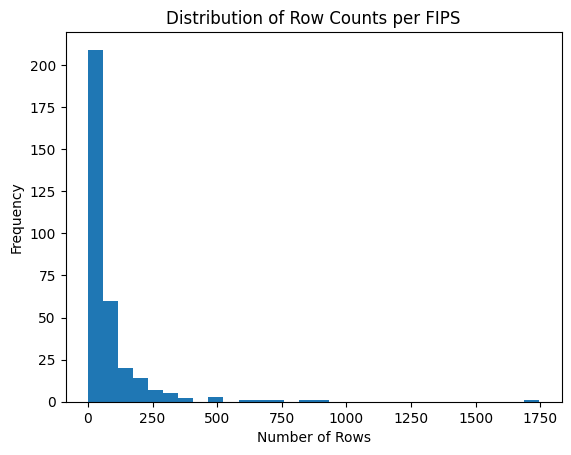

In [25]:
# plot the distribution of counts of rows per FIPS in merged_df
merged_df.groupby('FIPS').size().plot(kind='hist', bins=30, title='Distribution of Row Counts per FIPS')
plt.xlabel('Number of Rows')
plt.ylabel('Frequency')
plt.show()


### Aggregate on a county level. (because the access data is on county level)
Sum population, take median prevalence (median more robust than mean, against outliers, several counties have only few tract level data points) , temporarily ignore the CIs (keep in mind for future more detailed analysis, drop for now)


In [26]:
agg_df = merged_df.groupby('FIPS').agg({
    'Population2010': 'sum',
    **{col: ('median' if col.endswith('Prev') else 'first') for col in merged_df.columns if col not in ['FIPS', 'Population2010']}
})


In [27]:
agg_df.head()

,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,ACCESS2_Crude95CI,ARTHRITIS_CrudePrev,...,LACCESS_HISP15,PCT_LACCESS_HISP15,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15
FIPS,,,,,,,,,,,,,,,,,,,,,
01073,268987,0,AL,Birmingham,107000,1073000100,0107000-01073000100,19.8,"(21.2, 27.8)",30.10,...,7097.673679,1.077910,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
01083,1521,118,AL,Huntsville,137000,1083020802,0137000-01083020802,14.2,"(12.5, 17.3)",20.65,...,426.741999,0.515501,30.414091,0.036740,60.606174,0.073212,2.237547,0.002703,422.220573,0.510039
01089,178484,120,AL,Huntsville,137000,1089000201,0137000-01089000201,14.3,"(20.6, 29.2)",31.65,...,4985.633169,1.489089,2694.851906,0.804888,611.201365,0.182551,78.926328,0.023573,4507.154947,1.346179
01097,195045,176,AL,Mobile,150000,1097000200,0150000-01097000200,18.6,"(15.8, 20.7)",30.70,...,2039.540255,0.493845,1982.744933,0.480093,565.076549,0.136825,56.559069,0.013695,2216.348385,0.536656
01101,205733,251,AL,Montgomery,151000,1101000100,0151000-01101000100,19.3,"(19.7, 31.0)",29.80,...,3031.370982,1.321648,713.323021,0.311002,186.454466,0.081292,60.286070,0.026284,2713.059912,1.182867


In [28]:
agg_df.shape

(326, 108)

In [29]:
ci_cols = [col for col in agg_df.columns if col.endswith('CI')]
agg_df = agg_df.drop(columns=ci_cols)
agg_df.head()

,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,ARTHRITIS_CrudePrev,BINGE_CrudePrev,...,LACCESS_HISP15,PCT_LACCESS_HISP15,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15
FIPS,,,,,,,,,,,,,,,,,,,,,
01073,268987,0,AL,Birmingham,107000,1073000100,0107000-01073000100,19.8,30.10,11.6,...,7097.673679,1.077910,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462
01083,1521,118,AL,Huntsville,137000,1083020802,0137000-01083020802,14.2,20.65,17.4,...,426.741999,0.515501,30.414091,0.036740,60.606174,0.073212,2.237547,0.002703,422.220573,0.510039
01089,178484,120,AL,Huntsville,137000,1089000201,0137000-01089000201,14.3,31.65,12.8,...,4985.633169,1.489089,2694.851906,0.804888,611.201365,0.182551,78.926328,0.023573,4507.154947,1.346179
01097,195045,176,AL,Mobile,150000,1097000200,0150000-01097000200,18.6,30.70,13.5,...,2039.540255,0.493845,1982.744933,0.480093,565.076549,0.136825,56.559069,0.013695,2216.348385,0.536656
01101,205733,251,AL,Montgomery,151000,1101000100,0151000-01101000100,19.3,29.80,13.6,...,3031.370982,1.321648,713.323021,0.311002,186.454466,0.081292,60.286070,0.026284,2713.059912,1.182867


Most health outcome data from 2017. Could be good to look at 2010 statistics to see long term effects of food access? Could also argue for shorter term statistics if food access is something that changes a lot.

After looking at data availability: 2015 statistics are more available across the different population demographics

future work point: Look into the % change columns for more information here.

In [30]:
# Select the columns ending with 'Prev'
prev_cols = [col for col in agg_df.columns if col.endswith('Prev')]



List access variables to focus on initially.

In [31]:
access_vars = ['PCT_LACCESS_POP','PCT_LACCESS_LOWI','PCT_LACCESS_HHNV',
               'PCT_LACCESS_CHILD','PCT_LACCESS_SENIORS','PCT_LACCESS_WHITE',
               'PCT_LACCESS_BLACK','PCT_LACCESS_HISP','PCT_LACCESS_NHASIAN',
               'PCT_LACCESS_NHNA','PCT_LACCESS_NHPI','PCT_LACCESS_MULTIR']### SNAP households only data from 2015, several variables only data from there.

In [32]:
def var_corr_report(var_zoom,year_to_focus_on='2015'):
  year_suffix =year_to_focus_on[-2:]
  var_zoom = var_zoom + str(year_suffix)
  print("For outcome variable: ", var_zoom)
  correlations = agg_df[[var_zoom] + prev_cols].corr()

  # Filter for correlations with chosen variable
  pct_laccess_correlations = correlations[var_zoom][1:]
  #print("Correlation of ",var_zoom," with Prevalence Columns:\n", pct_laccess_correlations)

  #get and print max value correlation and the variable name from pct_laccess_correlations

  max_correlation = pct_laccess_correlations.max()
  max_correlation_variable = pct_laccess_correlations.idxmax()
  median_corr = pct_laccess_correlations.median()

  print(f"The maximum correlation is: {max_correlation}")
  print(f"The variable with the maximum correlation is: {max_correlation_variable}")
  print(f"The median correlation is: {median_corr}\n")


In [33]:
var_corr_report('PCT_LACCESS_POP','2015')

For outcome variable:  PCT_LACCESS_POP15
The maximum correlation is: 0.3092390129710677
The variable with the maximum correlation is: OBESITY_CrudePrev
The median correlation is: 0.16414552812659272



In [34]:
for access_var in access_vars:
  var_corr_report(access_var)

For outcome variable:  PCT_LACCESS_POP15
The maximum correlation is: 0.3092390129710677
The variable with the maximum correlation is: OBESITY_CrudePrev
The median correlation is: 0.16414552812659272

For outcome variable:  PCT_LACCESS_LOWI15
The maximum correlation is: 0.45229243650743234
The variable with the maximum correlation is: ACCESS2_CrudePrev
The median correlation is: 0.2845764835044057

For outcome variable:  PCT_LACCESS_HHNV15
The maximum correlation is: 0.5119647707194782
The variable with the maximum correlation is: BPHIGH_CrudePrev
The median correlation is: 0.33111799839063255

For outcome variable:  PCT_LACCESS_CHILD15
The maximum correlation is: 0.31259923216539803
The variable with the maximum correlation is: OBESITY_CrudePrev
The median correlation is: 0.10916067339964006

For outcome variable:  PCT_LACCESS_SENIORS15
The maximum correlation is: 0.4405248849340538
The variable with the maximum correlation is: ARTHRITIS_CrudePrev
The median correlation is: 0.254435786

From these correlations we can see mild/moderate correlations between general food access variables and health outcomes

Can't look at all health outcomes and actually be able to say anything at the moment. Because there is too much to digest simultaneously.

Solution: make a composite score of the prevalence of any of the 10 health outcomes highlighted by the CDC (as per 2017 USDA report summary): hypertension, coronary heart disease, hepatitis, stroke, cancer, asthma, diabetes, arthritis, copd, kidney disease.

In each composite score, mark the key driver of the score.

OR, mark score when out of 95% range of mean crude prevalence.

In [35]:
# Create a list of columns for composite
comp_cols = ['ARTHRITIS','BPHIGH','CASTHMA','CANCER','COPD','DIABETES','KIDNEY','STROKE']#,'OBESITY'] ## this one was not listed in the report but is obviously linked to food. Not sure why it's not here. Could also look at this for other analyses
comp_cols = [col+'_CrudePrev' for col in comp_cols]

# Calculate the sum of these columns and assign it to a new 'composite' column
agg_df['composite'] = agg_df[comp_cols].sum(axis=1)

# Display the updated dataframe with the 'composite' column
agg_df.head()


,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,ARTHRITIS_CrudePrev,BINGE_CrudePrev,...,PCT_LACCESS_HISP15,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15,composite
FIPS,,,,,,,,,,,,,,,,,,,,,
01073,268987,0,AL,Birmingham,107000,1073000100,0107000-01073000100,19.8,30.10,11.6,...,1.077910,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462,122.90
01083,1521,118,AL,Huntsville,137000,1083020802,0137000-01083020802,14.2,20.65,17.4,...,0.515501,30.414091,0.036740,60.606174,0.073212,2.237547,0.002703,422.220573,0.510039,83.05
01089,178484,120,AL,Huntsville,137000,1089000201,0137000-01089000201,14.3,31.65,12.8,...,1.489089,2694.851906,0.804888,611.201365,0.182551,78.926328,0.023573,4507.154947,1.346179,111.55
01097,195045,176,AL,Mobile,150000,1097000200,0150000-01097000200,18.6,30.70,13.5,...,0.493845,1982.744933,0.480093,565.076549,0.136825,56.559069,0.013695,2216.348385,0.536656,121.70
01101,205733,251,AL,Montgomery,151000,1101000100,0151000-01101000100,19.3,29.80,13.6,...,1.321648,713.323021,0.311002,186.454466,0.081292,60.286070,0.026284,2713.059912,1.182867,116.40


In [36]:
# Select columns starting with 'PCT_LACCESS'
pct_laccess_cols = [col for col in agg_df.columns if col.startswith('PCT_LACCESS')]

# Iterate through the selected columns and create scatter plots
for col in pct_laccess_cols:
  fig = px.scatter(agg_df, x=col, y='composite',
                   title=f'{col} vs Composite Score',
                   labels={col: col, 'composite': 'Composite Score'})
  fig.update_layout(height=600,width=600)
  fig.show()


Look at the distribution of food access and mark lowest food access 25% (highest quartile)

In [37]:
upper_quartile_pct_laccess_pop15 = agg_df['PCT_LACCESS_POP15'].quantile(0.75)
print(f"The upper quartile of PCT_LACCESS_POP15 is: {upper_quartile_pct_laccess_pop15}")


The upper quartile of PCT_LACCESS_POP15 is: 27.069731656259382


In [38]:
# box plot of pct_laccess_pop15 with markers

fig = go.Figure()
fig.add_trace(go.Box(
    y=agg_df['PCT_LACCESS_POP15'],
    boxpoints='all',  # Show all points
    jitter=0.3,       # Add some jitter for better visualization
    pointpos=-1.8,    # Place points slightly to the left
    name='PCT_LACCESS_POP15'
))

fig.update_layout(title='Box Plot of Percentage Low Access Population 2015',
                  yaxis_title='Percentage (%) low access',xaxis_title=' ',
                  width=800,height=600)

fig.show()


In [39]:
### add new column to data where percentage of population with low access is more than Q3
agg_df['low_access_pop'] = agg_df['PCT_LACCESS_POP15'].apply(lambda x:'above Q3 % low access' if x > upper_quartile_pct_laccess_pop15 else 'below Q3')

In [40]:
agg_df.head()

,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,ARTHRITIS_CrudePrev,BINGE_CrudePrev,...,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15,composite,low_access_pop
FIPS,,,,,,,,,,,,,,,,,,,,,
01073,268987,0,AL,Birmingham,107000,1073000100,0107000-01073000100,19.8,30.10,11.6,...,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462,122.90,above Q3 % low access
01083,1521,118,AL,Huntsville,137000,1083020802,0137000-01083020802,14.2,20.65,17.4,...,30.414091,0.036740,60.606174,0.073212,2.237547,0.002703,422.220573,0.510039,83.05,below Q3
01089,178484,120,AL,Huntsville,137000,1089000201,0137000-01089000201,14.3,31.65,12.8,...,2694.851906,0.804888,611.201365,0.182551,78.926328,0.023573,4507.154947,1.346179,111.55,below Q3
01097,195045,176,AL,Mobile,150000,1097000200,0150000-01097000200,18.6,30.70,13.5,...,1982.744933,0.480093,565.076549,0.136825,56.559069,0.013695,2216.348385,0.536656,121.70,below Q3
01101,205733,251,AL,Montgomery,151000,1101000100,0151000-01101000100,19.3,29.80,13.6,...,713.323021,0.311002,186.454466,0.081292,60.286070,0.026284,2713.059912,1.182867,116.40,above Q3 % low access


In [41]:
agg_df['low_access_pop'].value_counts()

,count
low_access_pop,
below Q3,245
above Q3 % low access,81


In [42]:
245+81 ### verifying this is still 326

326

If we only focus on populations where the overall access is in the highest quartile across counties, let's zoom in and see which these are.

In [43]:
low_access_counties = agg_df[agg_df['low_access_pop'] == 'above Q3 % low access']
low_access_counties.head()

,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,ARTHRITIS_CrudePrev,BINGE_CrudePrev,...,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15,composite,low_access_pop
FIPS,,,,,,,,,,,,,,,,,,,,,
01073,268987,0,AL,Birmingham,107000,1073000100,0107000-01073000100,19.80,30.1,11.60,...,1808.048713,0.274585,476.945542,0.072433,80.060491,0.012159,6376.995723,0.968462,122.90,above Q3 % low access
01101,205733,251,AL,Montgomery,151000,1101000100,0151000-01101000100,19.30,29.8,13.60,...,713.323021,0.311002,186.454466,0.081292,60.286070,0.026284,2713.059912,1.182867,116.40,above Q3 % low access
02020,291826,345,AK,Anchorage,203000,2020000101,0203000-02020000101,12.80,19.9,20.10,...,5615.873556,1.924391,4872.123999,1.669530,844.011828,0.289217,7178.471845,2.459847,79.10,above Q3 % low access
08101,106585,7338,CO,Pueblo,862000,8101000100,0862000-08101000100,20.15,26.7,14.55,...,420.509801,0.264367,989.919234,0.622344,42.191170,0.026525,9123.646776,5.735870,100.35,above Q3 % low access
09001,433368,7441,CT,Bridgeport,908000,9001070100,0908000-09001070100,14.85,20.2,17.10,...,9284.399082,1.012664,342.475182,0.037354,65.082076,0.007099,8451.469827,0.921815,82.15,above Q3 % low access


In [44]:
low_access_counties.reset_index(inplace=True)

In [45]:
low_access_counties['FIPS'].unique().shape

(81,)

Do they have different health outcomes than other counties?

In [46]:
  col = 'composite'
  g1 = agg_df[agg_df['low_access_pop'] == 'above Q3 % low access'][col]
  g2 = agg_df[agg_df['low_access_pop'] == 'below Q3'][col]
  t_stat, p_val = stats.ttest_ind(g1, g2)
  fig = px.box(agg_df, x='low_access_pop',y=col,color='low_access_pop')
  #fig.add_annotation("T-statistic: ",t_stat)
  #fig.add_annotation("P-value: ",p_val)
  print("For health outcome: ",col)
  print("T-statistic:", t_stat)
  annotation_t = "T-statistic: "+str(t_stat)
  print("P-value:", p_val)
  fig.update_layout(height=600,width=600)
  fig.update_layout(title=f'Box plot of {col} by low access population',
                    yaxis_title=f"{col}", legend_title='Subset of population',
                    annotations=[{'text':(f"T-statistic: {t_stat:.2f}"),
                                  'xref':'paper','yref':'paper',
                                  'x':1.4, 'y':0.7,'showarrow':False},
                                 {'text':(f"P-value: {p_val:.5f}"),
                                  'xref':'paper','yref':'paper',
                                  'x':1.4, 'y':0.67,'showarrow':False}])
  fig.show()

For health outcome:  composite
T-statistic: 4.042593955122859
P-value: 6.610202701922182e-05


In [47]:
for col in comp_cols:
  g1 = agg_df[agg_df['low_access_pop'] == 'above Q3 % low access'][col]
  g2 = agg_df[agg_df['low_access_pop'] == 'below Q3'][col]
  t_stat, p_val = stats.ttest_ind(g1, g2)
  fig = px.box(agg_df, x='low_access_pop',y=col,color='low_access_pop')
  #fig.add_annotation("T-statistic: ",t_stat)
  #fig.add_annotation("P-value: ",p_val)
  print("For health outcome: ",col)
  print("T-statistic:", t_stat)
  annotation_t = "T-statistic: "+str(t_stat)
  print("P-value:", p_val)
  fig.update_layout(height=600,width=600)
  fig.update_layout(title=f'Box plot of {col} by low access population',
                    yaxis_title=f"{col}", legend_title='Subset of population',
                    annotations=[{'text':(f"T-statistic: {t_stat:.2f}"),
                                  'xref':'paper','yref':'paper',
                                  'x':1.4, 'y':0.7,'showarrow':False},
                                 {'text':(f"P-value: {p_val:.5f}"),
                                  'xref':'paper','yref':'paper',
                                  'x':1.4, 'y':0.67,'showarrow':False}])
  fig.write_image(f"{col} boxplot.png")
  fig.show()

For health outcome:  ARTHRITIS_CrudePrev
T-statistic: 4.3188394925993885
P-value: 2.0878890026950742e-05


For health outcome:  BPHIGH_CrudePrev
T-statistic: 3.688459034955835
P-value: 0.00026450570766510035


For health outcome:  CASTHMA_CrudePrev
T-statistic: 2.4849762685063377
P-value: 0.013460323536973176


For health outcome:  CANCER_CrudePrev
T-statistic: 2.0582943634727933
P-value: 0.04036126820429582


For health outcome:  COPD_CrudePrev
T-statistic: 3.5690198474476196
P-value: 0.0004125049384563705


For health outcome:  DIABETES_CrudePrev
T-statistic: 3.001235346437541
P-value: 0.0028976620845416893


For health outcome:  KIDNEY_CrudePrev
T-statistic: 2.615111530121069
P-value: 0.009336933741251082


For health outcome:  STROKE_CrudePrev
T-statistic: 3.1396339139120175
P-value: 0.001847308212508699


For each of the low access counties, deep-dive into health outcomes. Which counties have the lowest health outcomes? Which health outcomes are lowest?

(reverse order list access)

In [48]:
low_access_counties.reset_index(inplace=True)

In [ ]:
# Sort low_access_counties by PCT_LACCESS_POP15 in descending order
sorted_low_access_counties = low_access_counties.sort_values('PCT_LACCESS_POP15', ascending=False)

# Get the top 20 counties
top_20_counties = sorted_low_access_counties.head(20)

In [50]:
sorted_low_access_counties.head()

,index,FIPS,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,...,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15,composite,low_access_pop
60,60,47065,167596,22054,TN,Chattanooga,4714000,47065000400,4714000-47065000400,17.7,...,2160.870873,0.642231,402.963786,0.119765,68.763976,0.020437,4008.058064,1.191233,110.50,above Q3 % low access
31,31,25023,93810,13216,MA,Brockton,2509000,25023510100,2509000-25023510100,12.0,...,1852.504282,0.374305,437.079178,0.088313,47.599503,0.009618,5348.021225,1.080585,105.70,above Q3 % low access
71,71,48451,93198,25085,TX,San Angelo,4864472,48451000100,4864472-48451000100,23.9,...,492.836002,0.447122,380.364201,0.345083,50.126674,0.045477,5390.354897,4.890364,92.40,above Q3 % low access
7,7,12009,179156,8477,FL,Melbourne,1243975,12009064102,1243975-12009064102,20.6,...,4219.502756,0.776535,891.405579,0.164049,194.855141,0.035860,8999.233437,1.656171,107.35,above Q3 % low access
42,42,35013,97601,16167,NM,Las Cruces,3539380,35013000102,3539380-35013000102,17.6,...,616.439601,0.294619,1059.839321,0.506535,72.889647,0.034837,17921.233977,8.565204,92.20,above Q3 % low access


Let's zoom in to the top 20 counties (with lowest access, aka highest % low access)

In [52]:
list_lacc_countiesFIPS_top20 = top_20_counties['FIPS'].tolist()
list_lacc_countiesFIPS_top20

['47065',
 '25023',
 '48451',
 '12009',
 '35013',
 '13245',
 '13095',
 '48309',
 '29183',
 '13153',
 '48485',
 '08101',
 '12111',
 '37067',
 '47093',
 '28047',
 '35043',
 '55133',
 '17097',
 '29165']

In [53]:
list_lacc_countiesFIPS = low_access_counties['FIPS'].tolist()
list_lacc_countiesFIPS

['01073',
 '01101',
 '02020',
 '08101',
 '09001',
 '09003',
 '09009',
 '12009',
 '12035',
 '12073',
 '12105',
 '12111',
 '12127',
 '13059',
 '13095',
 '13153',
 '13215',
 '13245',
 '17097',
 '17113',
 '17197',
 '18003',
 '18057',
 '18089',
 '18141',
 '19013',
 '20173',
 '22017',
 '25005',
 '25009',
 '25021',
 '25023',
 '25027',
 '26049',
 '26065',
 '26125',
 '28047',
 '29037',
 '29047',
 '29165',
 '29183',
 '33011',
 '35013',
 '35043',
 '35049',
 '36055',
 '37051',
 '37067',
 '37071',
 '37129',
 '37133',
 '39061',
 '39151',
 '39153',
 '40031',
 '40113',
 '40145',
 '41053',
 '44003',
 '46103',
 '47065',
 '47093',
 '47125',
 '47157',
 '48027',
 '48167',
 '48215',
 '48309',
 '48329',
 '48355',
 '48441',
 '48451',
 '48485',
 '48491',
 '49011',
 '51650',
 '53053',
 '53073',
 '55101',
 '55133',
 '56021']

In [54]:
# plot counts of StateAbbr in top_20_counties using plotly

# Count the occurrences of each StateAbbr in top_20_counties
state_abbr_counts = low_access_counties['StateAbbr'].value_counts()

# Create a bar plot using Plotly
fig = px.bar(state_abbr_counts, x=state_abbr_counts.index, y=state_abbr_counts.values,
             labels={'x': 'State Abbreviation', 'y': 'Count'},
             title='Counts of State Abbreviations in Counties with Highest (top 25%) PCT_LACCESS_POP15 with health data')

fig.show()


## Comparing selected focus counties vs all counties in access data

Not all counties included in access have health outcomes. Where do the included counties rank out of all counties?

In [55]:
df2_sort = df2.sort_values(by='PCT_LACCESS_POP15',ascending=False)
df2_sort['rank'] = df2_sort['PCT_LACCESS_POP15'].rank(ascending=False)
df2_sort.head()

,index,FIPS,State,County,LACCESS_POP10,LACCESS_POP15,PCH_LACCESS_POP_10_15,PCT_LACCESS_POP10,PCT_LACCESS_POP15,LACCESS_LOWI10,...,PCT_LACCESS_HISP15,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15,rank
1712,1712,31117,NE,McPherson,539.000005,539.000005,0.000000e+00,100.000001,100.000001,136.427386,...,0.371058,0.0,0.000000,0.000000,0.000000,0.0,0.000000,8.000000,1.484230,1.0
1656,1656,31005,NE,Arthur,460.000004,460.000004,0.000000e+00,100.000001,100.000001,167.370893,...,4.130435,1.0,0.217391,2.000000,0.434783,0.0,0.000000,18.000001,3.913044,2.0
72,72,02068,AK,Denali,1826.000014,1826.000014,0.000000e+00,100.000001,100.000001,338.312491,...,2.300110,19.0,1.040526,65.000000,3.559693,1.0,0.054765,94.000000,5.147864,3.0
567,567,16033,ID,Clark,982.000006,982.000006,0.000000e+00,100.000001,100.000001,588.970834,...,40.529532,5.0,0.509165,10.000000,1.018330,0.0,0.000000,249.000005,25.356416,4.0
1796,1796,35003,NM,Catron,3725.000021,3725.000021,2.685756e-13,100.000001,100.000001,1664.513780,...,19.033557,7.0,0.187919,99.000001,2.657718,0.0,0.000000,259.000001,6.953020,5.0


In [56]:
df2_sort['top_20_withhealth']=df2_sort['FIPS'].isin(list_lacc_countiesFIPS)
df2_sort.head()

,index,FIPS,State,County,LACCESS_POP10,LACCESS_POP15,PCH_LACCESS_POP_10_15,PCT_LACCESS_POP10,PCT_LACCESS_POP15,LACCESS_LOWI10,...,LACCESS_NHASIAN15,PCT_LACCESS_NHASIAN15,LACCESS_NHNA15,PCT_LACCESS_NHNA15,LACCESS_NHPI15,PCT_LACCESS_NHPI15,LACCESS_MULTIR15,PCT_LACCESS_MULTIR15,rank,top_20_withhealth
1712,1712,31117,NE,McPherson,539.000005,539.000005,0.000000e+00,100.000001,100.000001,136.427386,...,0.0,0.000000,0.000000,0.000000,0.0,0.000000,8.000000,1.484230,1.0,False
1656,1656,31005,NE,Arthur,460.000004,460.000004,0.000000e+00,100.000001,100.000001,167.370893,...,1.0,0.217391,2.000000,0.434783,0.0,0.000000,18.000001,3.913044,2.0,False
72,72,02068,AK,Denali,1826.000014,1826.000014,0.000000e+00,100.000001,100.000001,338.312491,...,19.0,1.040526,65.000000,3.559693,1.0,0.054765,94.000000,5.147864,3.0,False
567,567,16033,ID,Clark,982.000006,982.000006,0.000000e+00,100.000001,100.000001,588.970834,...,5.0,0.509165,10.000000,1.018330,0.0,0.000000,249.000005,25.356416,4.0,False
1796,1796,35003,NM,Catron,3725.000021,3725.000021,2.685756e-13,100.000001,100.000001,1664.513780,...,7.0,0.187919,99.000001,2.657718,0.0,0.000000,259.000001,6.953020,5.0,False


In [58]:
agg_df=agg_df.reset_index('FIPS')

In [59]:
agg_df['FIPS'].unique().shape

(326,)

In [60]:

list_FIPScounties_withhealth = agg_df['FIPS'].tolist()
len(list_FIPScounties_withhealth)

326

In [61]:

df2_sort['has_healthdata']=df2_sort['FIPS'].isin(list_FIPScounties_withhealth)
df2_sort['has_healthdata'].value_counts()

,count
has_healthdata,
False,2817
True,326


Some counties have 100% low access defined individuals. This could be skewed by rural vs urban, however the low access measure has taken this into account by defining the measure differently depending on urban vs rural

In [62]:
px.scatter(df2_sort,x='LACCESS_POP15',y='PCT_LACCESS_POP15',color='top_20_withhealth',opacity=0.7)

In [63]:
px.scatter(df2_sort,x='LACCESS_POP15',y='PCT_LACCESS_POP15',color='has_healthdata',opacity=0.7)

In [64]:
px.scatter(df2_sort,x='LACCESS_POP15',y='PCT_LACCESS_LOWI15',color='has_healthdata',opacity=0.7)

## How to further prioritize? In low access counties, where are the health outcomes particularly bad?

In [65]:
agg_df['top_20_county_withhealth']=agg_df['FIPS'].isin(list_lacc_countiesFIPS)
agg_df['top_20_county_withhealth'].value_counts()

,count
top_20_county_withhealth,
False,245
True,81


In [66]:
for col in comp_cols+['OBESITY_CrudePrev']:
  fig = px.histogram(agg_df, x=col, color="low_access_pop", marginal="rug", hover_name="County")
  fig.show()

In [67]:
## for each of the columns we want to look at, mark counties with top 25% prevalence (bad)
for col in comp_cols+['OBESITY_CrudePrev']:
  topQ = agg_df[col].quantile(0.75)
  col_name = col+'_topQ'
  agg_df[col_name]=agg_df[col].apply(lambda x:1 if x > topQ else 0)

### calculate risk score (high prevalence of many of the different outcomes simultaneously, high amenability to intervention?)
cols_to_sum = [x+'_topQ' for x in comp_cols+['OBESITY_CrudePrev']]
agg_df['risk_col_sum']=agg_df[cols_to_sum].sum(axis=1)
agg_df.head()

,FIPS,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,ARTHRITIS_CrudePrev,...,ARTHRITIS_CrudePrev_topQ,BPHIGH_CrudePrev_topQ,CASTHMA_CrudePrev_topQ,CANCER_CrudePrev_topQ,COPD_CrudePrev_topQ,DIABETES_CrudePrev_topQ,KIDNEY_CrudePrev_topQ,STROKE_CrudePrev_topQ,OBESITY_CrudePrev_topQ,risk_col_sum
0,01073,268987,0,AL,Birmingham,107000,1073000100,0107000-01073000100,19.8,30.10,...,1,1,1,0,1,1,1,1,1,8
1,01083,1521,118,AL,Huntsville,137000,1083020802,0137000-01083020802,14.2,20.65,...,0,0,1,0,0,0,0,0,0,1
2,01089,178484,120,AL,Huntsville,137000,1089000201,0137000-01089000201,14.3,31.65,...,1,1,0,1,1,0,0,0,0,4
3,01097,195045,176,AL,Mobile,150000,1097000200,0150000-01097000200,18.6,30.70,...,1,1,1,1,1,1,1,1,1,9
4,01101,205733,251,AL,Montgomery,151000,1101000100,0151000-01101000100,19.3,29.80,...,1,1,1,0,1,1,1,1,1,8


In [ ]:

# Create distplot with custom bin_size
import plotly.figure_factory as ff
hist_data = [agg_df[agg_df['low_access_pop']=='below Q3']['risk_col_sum'],agg_df[agg_df['low_access_pop']=='above Q3 % low access']['risk_col_sum']]
group_labels = ['75% of counties','top 25% of counties']
fig = ff.create_distplot(hist_data, group_labels,show_rug=False)#, bin_size=.2)
fig.update_layout(height=600,width=800)
fig.show()


In [68]:
## calculate # of people included in intervention with different rules for county inclusion
risk_threshold = 5
cond1 = lambda x: x.low_access_pop =='above Q3 % low access' ## agg_df['low_access_pop']
cond2 = lambda x: x.risk_col_sum > risk_threshold ## input = agg_df['risk_col_sum']
cond3 = lambda x: cond1(x)+cond2(x) ## if either is True, true
cond4 = lambda x: cond1(x)*cond2(x) ## if both are True
rule_set = [cond1,cond2,cond3,cond4]


rule_sets = []
risk_thresholds = []
num_counties = []
num_people = []
## iterate over thresholds to calculate risk group sizes
for risk_threshold in range(3,9):
  print("Risk threshold: ",risk_threshold)
  rs_idx = 0
  for rs in rule_set:
    rs_idx +=1
    filt_counties = rs(agg_df)
    filt_agg_df = agg_df[filt_counties==True]
    print("# of counties: ",filt_agg_df.shape[0])
    print("# of people: ",filt_agg_df['Population2010'].sum())
    rule_sets.append(str(rs_idx))
    risk_thresholds.append(risk_threshold)
    num_counties.append(filt_agg_df.shape[0])
    num_people.append(filt_agg_df['Population2010'].sum())

data={
    'rule_set':rule_sets,
    'risk_threshold':risk_thresholds,
    'num_counties':num_counties,
    'num_people':num_people
}
pop_counts = pd.DataFrame(data)

Risk threshold:  3
# of counties:  81
# of people:  12044575
# of counties:  87
# of people:  18316469
# of counties:  136
# of people:  25456726
# of counties:  32
# of people:  4904318
Risk threshold:  4
# of counties:  81
# of people:  12044575
# of counties:  71
# of people:  12878197
# of counties:  126
# of people:  20789691
# of counties:  26
# of people:  4133081
Risk threshold:  5
# of counties:  81
# of people:  12044575
# of counties:  53
# of people:  9153684
# of counties:  114
# of people:  17642829
# of counties:  20
# of people:  3555430
Risk threshold:  6
# of counties:  81
# of people:  12044575
# of counties:  44
# of people:  7776322
# of counties:  108
# of people:  16716772
# of counties:  17
# of people:  3104125
Risk threshold:  7
# of counties:  81
# of people:  12044575
# of counties:  25
# of people:  4419498
# of counties:  96
# of people:  14946077
# of counties:  10
# of people:  1517996
Risk threshold:  8
# of counties:  81
# of people:  12044575
# of cou

In [69]:
## THESE POPULATION NUMBERS ARE BASED ON CENSUS TRACTS INCLUDED IN THE 500 CITIES PROJECT THAT AREN'T NECESSARILY ALL TRACTS IN A PARTICULAR COUNTY (the access dataset would've helped)

In [70]:
fig = px.histogram(agg_df, x='risk_col_sum',)#color='low_access_pop')
fig.update_layout(xaxis_title='Risk Score',yaxis_title='Count',height=600,width=800)
fig.show()

In [76]:
bar1=go.Bar(x=pop_counts[pop_counts['rule_set']=='1']['risk_threshold'],y=pop_counts[pop_counts['rule_set']=='1']['num_people'],name='Access-based intervention',marker=dict(color='#648fff'))
bar2=go.Bar(x=pop_counts[pop_counts['rule_set']=='2']['risk_threshold'],y=pop_counts[pop_counts['rule_set']=='2']['num_people'],name='Health-based intervention',marker=dict(color='#dc267f'))
bar3=go.Bar(x=pop_counts[pop_counts['rule_set']=='3']['risk_threshold'],y=pop_counts[pop_counts['rule_set']=='3']['num_people'],name='Either condition met: Access OR health',marker=dict(color='#785ef0'))
bar4=go.Bar(x=pop_counts[pop_counts['rule_set']=='4']['risk_threshold'],y=pop_counts[pop_counts['rule_set']=='4']['num_people'],name='Both condition met: Access AND health',marker=dict(color='#ffb000'))
fig = go.Figure(data=[bar1,bar2,bar3,bar4])
fig.update_layout(xaxis_title='Risk Threshold',yaxis_title='Number of People',height=600,width=800)
fig.write_image("risk_threshold_people.png")
fig.show()

In [77]:
bar1=go.Bar(x=pop_counts[pop_counts['rule_set']=='1']['risk_threshold'],y=pop_counts[pop_counts['rule_set']=='1']['num_counties'],name='Access-based intervention',marker=dict(color='#648fff'))
bar2=go.Bar(x=pop_counts[pop_counts['rule_set']=='2']['risk_threshold'],y=pop_counts[pop_counts['rule_set']=='2']['num_counties'],name='Health-based intervention',marker=dict(color='#dc267f'))
bar3=go.Bar(x=pop_counts[pop_counts['rule_set']=='3']['risk_threshold'],y=pop_counts[pop_counts['rule_set']=='3']['num_counties'],name='Either condition met: Access OR health',marker=dict(color='#785ef0'))
bar4=go.Bar(x=pop_counts[pop_counts['rule_set']=='4']['risk_threshold'],y=pop_counts[pop_counts['rule_set']=='4']['num_counties'],name='Both condition met: Access AND health',marker=dict(color='#ffb000'))
fig = go.Figure(data=[bar1,bar2,bar3,bar4])
fig.update_layout(xaxis_title='Risk Threshold',yaxis_title='Number of Counties',height=600,width=800)
fig.write_image("risk_threshold_counties.png")
fig.show()

Let's take the risk threshold set to 6, so 7, 8 and 9 are identified as highest-risk. + purple rule set (rule set 4) is the strictest: also requires low food access. Dive into these metrics.

In [78]:
highest_risk_counties = agg_df[(agg_df['risk_col_sum']>6)&(agg_df['low_access_pop']=='above Q3 % low access')]
highest_risk_counties.head()

,FIPS,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,ARTHRITIS_CrudePrev,...,ARTHRITIS_CrudePrev_topQ,BPHIGH_CrudePrev_topQ,CASTHMA_CrudePrev_topQ,CANCER_CrudePrev_topQ,COPD_CrudePrev_topQ,DIABETES_CrudePrev_topQ,KIDNEY_CrudePrev_topQ,STROKE_CrudePrev_topQ,OBESITY_CrudePrev_topQ,risk_col_sum
0,01073,268987,0,AL,Birmingham,107000,1073000100,0107000-01073000100,19.8,30.1,...,1,1,1,0,1,1,1,1,1,8
4,01101,205733,251,AL,Montgomery,151000,1101000100,0151000-01101000100,19.3,29.8,...,1,1,1,0,1,1,1,1,1,8
61,12035,75178,8762,FL,Palm Coast,1254200,12035060103,1254200-12035060103,19.7,29.2,...,1,1,0,1,1,1,1,1,0,7
69,12105,97405,8388,FL,Lakeland,1238250,12105010300,1238250-12105010300,23.0,27.2,...,1,1,0,1,1,1,1,1,0,7
76,13095,77434,9158,GA,Albany,1301052,13095000100,1301052-13095000100,26.7,24.7,...,0,1,1,0,1,1,1,1,1,7


In [79]:
highest_risk_counties.shape

(17, 94)

17 counties identified. Which ones?

In [80]:
highest_risk_counties['County']

,County
0,Jefferson
4,Montgomery
61,Flagler
69,Polk
76,Dougherty
80,Muscogee
82,Richmond
101,Lake
104,St. Joseph
121,Caddo


In [81]:
highest_risk_counties['LACCESS_POP15'].sum()

2141376.0536427163

In [82]:
highest_risk_counties['LACCESS_LOWI15'].sum()

738756.1005737337

In [89]:
# PCT_LACCESS_POP15 and PCT_LACCESS_LOWI15 on top of each other
fig = go.Figure(data=[
    go.Bar(name='% low access', x=highest_risk_counties['County'], y=highest_risk_counties['PCT_LACCESS_POP15'],hovertext=["FIPS: "+v for v in highest_risk_counties['FIPS']],text=[f'{v:.1f}' for v in highest_risk_counties['PCT_LACCESS_POP15']]),
    go.Bar(name='% low access, low income', x=highest_risk_counties['County'], y=highest_risk_counties['PCT_LACCESS_LOWI15'],text=[f'{v:.1f}' for v in highest_risk_counties['PCT_LACCESS_LOWI15']])
])
fig.add_hline(y=agg_df['PCT_LACCESS_POP15'].median(), line_dash="dash", line_color="lightblue", annotation_text="Population % Low Access Median", annotation_position="top right",annotation_bgcolor='white',annotation_opacity=0.7)
fig.add_hline(y=agg_df['PCT_LACCESS_LOWI15'].median(), line_dash="dash", line_color="darkgrey", annotation_text="Population % Low Access, low income Median", annotation_position="bottom left",annotation_bgcolor='white',annotation_opacity=0.7)


fig.update_layout(barmode='group',
                  xaxis_title='County',
                  yaxis_title='% of Population',
                  title='Percentage low access population and low access + low income in Highest Risk Counties',
                  xaxis_tickangle=-45,  # Rotate x-axis labels for readability
                  height=600,
                  width=1200)
fig.write_image("perc low access low income high risk.png")
fig.show()


Racial distribution for highest risk counties

In [92]:
import re

def get_string_between(input_string):
  """
  Extracts the string between '_' and '15' in a given input string.

  Args:
    input_string: The input string.

  Returns:
    The extracted string, or None if no match is found.
  """
  match = re.search(r'_([^_]+)15', input_string)
  if match:
    return match.group(1)
  else:
    return None

# Example usage:
input_string = 'PCT_LACCESS_POP15'
extracted_string = get_string_between(input_string)

if extracted_string:
  print(f"Extracted string: {extracted_string}")
else:
  print("No match found.")


Extracted string: POP


In [93]:
race_cols = ['LACCESS_WHITE15','LACCESS_BLACK15','LACCESS_HISP15','LACCESS_NHASIAN15','LACCESS_NHNA15','LACCESS_NHPI15','LACCESS_MULTIR15']
for rcol in race_cols:
  new_col_name = get_string_between(rcol)+'_percofLow'
  highest_risk_counties[new_col_name] = (highest_risk_counties[rcol]/highest_risk_counties['LACCESS_POP15'])*100
highest_risk_counties.head()


<ipython-input-93-d12cdd64e4b7>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-93-d12cdd64e4b7>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-93-d12cdd64e4b7>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-93-d12cdd6

,FIPS,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,ARTHRITIS_CrudePrev,...,STROKE_CrudePrev_topQ,OBESITY_CrudePrev_topQ,risk_col_sum,WHITE_percofLow,BLACK_percofLow,HISP_percofLow,NHASIAN_percofLow,NHNA_percofLow,NHPI_percofLow,MULTIR_percofLow
0,01073,268987,0,AL,Birmingham,107000,1073000100,0107000-01073000100,19.8,30.1,...,1,1,8,46.147479,49.601748,3.451205,0.879154,0.231912,0.038929,3.100779
4,01101,205733,251,AL,Montgomery,151000,1101000100,0151000-01101000100,19.3,29.8,...,1,1,8,28.956795,65.493058,4.580449,1.077842,0.281736,0.091093,4.099476
61,12035,75178,8762,FL,Palm Coast,1254200,12035060103,1254200-12035060103,19.7,29.2,...,1,0,7,80.611532,12.179901,9.867201,2.571518,0.308104,0.062555,4.266391
69,12105,97405,8388,FL,Lakeland,1238250,12105010300,1238250-12105010300,23.0,27.2,...,1,0,7,80.044143,10.768429,16.018187,1.472226,0.416617,0.056858,7.241728
76,13095,77434,9158,GA,Albany,1301052,13095000100,1301052-13095000100,26.7,24.7,...,1,1,7,23.630915,73.652951,1.790055,0.615103,0.216865,0.092606,1.791560


# Demographic visualizations

In [94]:
fig = go.Figure(data=[
    go.Bar(name='White', x=highest_risk_counties['County'], y=highest_risk_counties['WHITE_percofLow']),
    go.Bar(name='Black', x=highest_risk_counties['County'], y=highest_risk_counties['BLACK_percofLow']),
    go.Bar(name='Hispanic ethnicity', x=highest_risk_counties['County'], y=highest_risk_counties['HISP_percofLow']),
    go.Bar(name='Asian', x=highest_risk_counties['County'], y=highest_risk_counties['NHASIAN_percofLow']),
    go.Bar(name='American Indian or Alaska Native', x=highest_risk_counties['County'], y=highest_risk_counties['NHNA_percofLow']),
    go.Bar(name='Hawaiian or Pacific Islander', x=highest_risk_counties['County'], y=highest_risk_counties['NHPI_percofLow']),
    go.Bar(name='Multiracial', x=highest_risk_counties['County'], y=highest_risk_counties['MULTIR_percofLow'])


])

#fig.add_hline(y=agg_df['POP'].median(), line_dash="dash", line_color="lightblue", annotation_text="Population % Low Access Median", annotation_position="top right",annotation_bgcolor='white',annotation_opacity=0.7)
#fig.add_hline(y=agg_df['LOWI'].median(), line_dash="dash", line_color="salmon", annotation_text="Population % Low Access, low income Median", annotation_position="bottom left",annotation_bgcolor='white',annotation_opacity=0.7)
# Update layout for better readability
fig.update_layout(barmode='stack',
                  xaxis_title='County',
                  yaxis_title='% of Population',
                  title='% of low food access population, <br>by demographic for Highest Risk Counties',
                  xaxis_tickangle=-45,  # Rotate x-axis labels for readability
                  height=600,
                  width=800)

fig.show()


In [95]:
fig = go.Figure(data=[
    go.Bar(name='Asian', x=highest_risk_counties['County'], y=[highest_risk_counties['NHASIAN_percofLow'].median()]),
    go.Bar(name='American Indian or Alaska Native', x=highest_risk_counties['County'], y=[highest_risk_counties['NHNA_percofLow'].median()]),
    go.Bar(name='Hawaiian or Pacific Islander', x=highest_risk_counties['County'], y=[highest_risk_counties['NHPI_percofLow'].median()]),
    go.Bar(name='Multiracial', x=highest_risk_counties['County'], y=[highest_risk_counties['MULTIR_percofLow'].median()]),
    go.Bar(name='Black', x=highest_risk_counties['County'], y=[highest_risk_counties['BLACK_percofLow'].median()]),
    go.Bar(name='Hispanic ethnicity', x=highest_risk_counties['County'], y=[highest_risk_counties['HISP_percofLow'].median()]),
    go.Bar(name='White', x=highest_risk_counties['County'], y=[highest_risk_counties['WHITE_percofLow'].median()]),


])

#fig.add_hline(y=agg_df['POP'].median(), line_dash="dash", line_color="lightblue", annotation_text="Population % Low Access Median", annotation_position="top right",annotation_bgcolor='white',annotation_opacity=0.7)
#fig.add_hline(y=agg_df['LOWI'].median(), line_dash="dash", line_color="salmon", annotation_text="Population % Low Access, low income Median", annotation_position="bottom left",annotation_bgcolor='white',annotation_opacity=0.7)
# Update layout for better readability
fig.update_layout(barmode='group',
                  yaxis_title='% of Population',
                  title='% of low food access population, <br>by demographic for Highest Risk Counties',
                  xaxis_tickangle=-45,  # Rotate x-axis labels for readability
                  height=600,
                  width=800)
fig.update_xaxes(showticklabels=False)


fig.show()


In [96]:
fig = go.Figure(data=[
    go.Bar(name='White', x=highest_risk_counties['County'], y=[highest_risk_counties['PCT_LACCESS_WHITE15'].median()]),
    go.Bar(name='Black', x=highest_risk_counties['County'], y=[highest_risk_counties['PCT_LACCESS_BLACK15'].median()]),
    go.Bar(name='Hispanic ethnicity', x=highest_risk_counties['County'], y=[highest_risk_counties['PCT_LACCESS_HISP15'].median()]),
    go.Bar(name='Asian', x=highest_risk_counties['County'], y=[highest_risk_counties['PCT_LACCESS_NHASIAN15'].median()]),
    go.Bar(name='American Indian or Alaska Native', x=highest_risk_counties['County'], y=[highest_risk_counties['PCT_LACCESS_NHNA15'].median()]),
    go.Bar(name='Hawaiian or Pacific Islander', x=highest_risk_counties['County'], y=[highest_risk_counties['PCT_LACCESS_NHPI15'].median()]),
    go.Bar(name='Multiracial', x=highest_risk_counties['County'], y=[highest_risk_counties['PCT_LACCESS_MULTIR15'].median()])


])

#fig.add_hline(y=agg_df['POP'].median(), line_dash="dash", line_color="lightblue", annotation_text="Population % Low Access Median", annotation_position="top right",annotation_bgcolor='white',annotation_opacity=0.7)
#fig.add_hline(y=agg_df['LOWI'].median(), line_dash="dash", line_color="salmon", annotation_text="Population % Low Access, low income Median", annotation_position="bottom left",annotation_bgcolor='white',annotation_opacity=0.7)
# Update layout for better readability
fig.update_layout(barmode='group',
                  yaxis_title='% of Population',
                  title='% of population with low food access, <br>by demographic for Highest Risk Counties',
                  xaxis_tickangle=-45,  # Rotate x-axis labels for readability
                  height=600,
                  width=800)
fig.update_xaxes(showticklabels=False)
fig.show()


In [97]:
fig = go.Figure(data=[
    go.Bar(name='White', x=agg_df['County'], y=[agg_df['PCT_LACCESS_WHITE15'].median()]),
    go.Bar(name='Black', x=agg_df['County'], y=[agg_df['PCT_LACCESS_BLACK15'].median()]),
    go.Bar(name='Hispanic ethnicity', x=agg_df['County'], y=[agg_df['PCT_LACCESS_HISP15'].median()]),
    go.Bar(name='Asian', x=agg_df['County'], y=[agg_df['PCT_LACCESS_NHASIAN15'].median()]),
    go.Bar(name='American Indian or Alaska Native', x=agg_df['County'], y=[agg_df['PCT_LACCESS_NHNA15'].median()]),
    go.Bar(name='Hawaiian or Pacific Islander', x=agg_df['County'], y=[agg_df['PCT_LACCESS_NHPI15'].median()]),
    go.Bar(name='Multiracial', x=agg_df['County'], y=[agg_df['PCT_LACCESS_MULTIR15'].median()])


])

#fig.add_hline(y=agg_df['POP'].median(), line_dash="dash", line_color="lightblue", annotation_text="Population % Low Access Median", annotation_position="top right",annotation_bgcolor='white',annotation_opacity=0.7)
#fig.add_hline(y=agg_df['LOWI'].median(), line_dash="dash", line_color="salmon", annotation_text="Population % Low Access, low income Median", annotation_position="bottom left",annotation_bgcolor='white',annotation_opacity=0.7)
# Update layout for better readability
fig.update_layout(barmode='group',
                  yaxis_title='% of Population',
                  title='% of population with low food access, <br>by demographic for All Counties with health data',
                  xaxis_tickangle=-45,  # Rotate x-axis labels for readability
                  height=600,
                  width=800)
fig.update_xaxes(showticklabels=False)


fig.show()


# for each of the counties in the highest risk group, look on a census tract level how health outcomes are distributed?

In [98]:
merged_df_highrisk = merged_df[merged_df['FIPS'].isin(highest_risk_counties['FIPS'])]
merged_df_highrisk.shape

(999, 109)

In [99]:
## aiming to answer questions on engagement + subgroup benefit + impact

In [100]:
gdf_high_risk = gdf_tot.loc[gdf_tot['FIPS'].isin(highest_risk_counties['FIPS'])]
gdf_high_risk.shape

(999, 116)

In [101]:
gdf_high_risk.explore(
    column = 'ACCESS2_CrudePrev',
    tooltip = ['PlaceName_x', 'ACCESS2_CrudePrev', 'Population2010'],
    tiles = 'CartoDB positron')

In [104]:
highest_risk_counties[highest_risk_counties['Population2010']==highest_risk_counties['Population2010'].max()]['County']

,County
254,Shelby


In [107]:
m=gdf_shelby.explore(
    column = 'CHECKUP_CrudePrev',
    tiles = 'CartoDB positron',
    cmap='viridis')

In [108]:
gdf_shelby = gdf_high_risk.loc[gdf_high_risk['County']=='Shelby']
gdf_shelby.explore(
    column = 'ACCESS2_CrudePrev',
    tooltip = ['PlaceName_x', 'ACCESS2_CrudePrev', 'CHECKUP_CrudePrev','Population2010'],
    tiles = 'CartoDB positron', cmap='viridis_r',
    m=m)


In [109]:
m

In [110]:
merged_df['ACCESS2_CrudePrev'].median() ## median across entire health dataset

15.0

In [111]:
merged_df['CHECKUP_CrudePrev'].median() ## median across entire health dataset

68.6

In [112]:
merged_df_highrisk['Population2010'].sum() ## total population in county census tracts identified as high risk

3104125

In [114]:
merged_df_highrisk[(merged_df_highrisk['ACCESS2_CrudePrev']<=15)|(merged_df_highrisk['CHECKUP_CrudePrev']>=68.6)]['Population2010'].sum() ## total population in county census tracts identified as high risk, where lack of access to insurance is <= 15% (nationwide median) OR where the prevalence of checkups is >= 68.6%

2835864

In [115]:
2835864/3104125

0.9135791889824024

In [116]:
merged_df_highrisk[(merged_df_highrisk['ACCESS2_CrudePrev']<=15)&(merged_df_highrisk['CHECKUP_CrudePrev']>=68.6)]['Population2010'].sum() ## total population in county census tracts identified as high risk, where lack of access to insurance is <= 15% (nationwide median) AND where the prevalence of checkups is >= 68.6%

800733

In [117]:
800733/3100000

0.2583009677419355

Which subgroups are more present in these high risk counties than in the overall dataset? Need to compare the proportion to the proportion low otherwise can't compare across

In [118]:
highest_risk_counties['BLACK_percofLow'].median()

28.129982479445935

In [119]:
race_cols = ['LACCESS_WHITE15','LACCESS_BLACK15','LACCESS_HISP15','LACCESS_NHASIAN15','LACCESS_NHNA15','LACCESS_NHPI15','LACCESS_MULTIR15']
for rcol in race_cols:
  new_col_name = get_string_between(rcol)+'_percofLow'
  agg_df[new_col_name] = (agg_df[rcol]/agg_df['LACCESS_POP15'])*100
agg_df.head()


,FIPS,Population2010,index_x,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,ACCESS2_CrudePrev,ARTHRITIS_CrudePrev,...,STROKE_CrudePrev_topQ,OBESITY_CrudePrev_topQ,risk_col_sum,WHITE_percofLow,BLACK_percofLow,HISP_percofLow,NHASIAN_percofLow,NHNA_percofLow,NHPI_percofLow,MULTIR_percofLow
0,01073,268987,0,AL,Birmingham,107000,1073000100,0107000-01073000100,19.8,30.10,...,1,1,8,46.147479,49.601748,3.451205,0.879154,0.231912,0.038929,3.100779
1,01083,1521,118,AL,Huntsville,137000,1083020802,0137000-01083020802,14.2,20.65,...,0,0,1,72.970096,21.510521,4.569255,0.325653,0.648929,0.023958,4.520843
2,01089,178484,120,AL,Huntsville,137000,1089000201,0137000-01089000201,14.3,31.65,...,0,0,4,65.322683,25.764085,5.630682,3.043516,0.690280,0.089138,5.090298
3,01097,195045,176,AL,Mobile,150000,1097000200,0150000-01097000200,18.6,30.70,...,1,1,9,62.236141,33.118208,1.965469,1.910736,0.544554,0.054505,2.135856
4,01101,205733,251,AL,Montgomery,151000,1101000100,0151000-01101000100,19.3,29.80,...,1,1,8,28.956795,65.493058,4.580449,1.077842,0.281736,0.091093,4.099476


In [120]:
agg_df['BLACK_percofLow'].median()

7.7632354599308036

In [121]:
agg_df['BLACK_percofLow'].median()

7.7632354599308036

In [122]:
race_cols_names = ['WHITE','BLACK','HISP','NHASIAN','NHNA','NHPI','MULTIR']
all_medians_list = []
high_medians_list = []
diff_list = []
color_list = []
for col in race_cols_names:
  if col == 'BLACK':
    color = 'red'
  else:
    color= 'navy'

  all_med = agg_df[col+'_percofLow'].median()
  high_med = highest_risk_counties[col+'_percofLow'].median()
  all_medians_list.append(all_med)
  high_medians_list.append(high_med)
  diff = high_med-all_med
  diff_list.append(diff)
  color_list.append(color)
  print(col,"ALL counties:",all_med)
  print(col, "difference: ", diff)

WHITE ALL counties: 77.80111058254879
WHITE difference:  -13.272543049986368
BLACK ALL counties: 7.7632354599308036
BLACK difference:  20.36674701951513
HISP ALL counties: 6.989795707526987
HISP difference:  -3.538591163508518
NHASIAN ALL counties: 2.3985989400131675
NHASIAN difference:  -0.9263730192371911
NHNA ALL counties: 0.43457106247833865
NHNA difference:  -0.15283546101203543
NHPI ALL counties: 0.05606779725520179
NHPI difference:  -0.015185256255018147
MULTIR ALL counties: 5.325585368057693
MULTIR difference:  -1.2261096037428763


In [123]:
fig=px.bar(x=race_cols_names,y=diff_list,color=color_list,text=[f'{v:.2f}' for v in diff_list])
fig.update_layout(title="Difference in median between all counties and high risk counties",xaxis_title='Race/Ethnicity',yaxis_title='Difference from Median (%)',height=600,width=800)
fig.update_layout(xaxis={'categoryorder': 'array', 'categoryarray': ['WHITE','BLACK','HISP','NHASIAN','NHNA','NHPI','MULTIR']})
fig.update_layout(showlegend=False)
fig.write_image("race_diff.png")
fig.show()